In [136]:
import pandas as pd
import matplotlib.pylab as plt
import plotly.graph_objs as go
import plotly.express as px
import matplotlib
import numpy as np

In [137]:
df = pd.read_csv("train-data.csv",encoding = "ISO-8859-1")
df1 = pd.read_csv("autos.csv",encoding = "ISO-8859-1")
df2 = pd.read_csv("Car details v3.csv", encoding = "ISO-8859-1")
df3 = pd.read_csv("Vehicle_Dataset.csv")

In [138]:
df.head()

,Unnamed: 0,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Price
0,0,Maruti Wagon R LXI CNG,Mumbai,2010,72000,CNG,Manual,First,26.6 km/kg,998 CC,58.16 bhp,5.0,NaN,1.75
1,1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.67 kmpl,1582 CC,126.2 bhp,5.0,NaN,12.50
2,2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.2 kmpl,1199 CC,88.7 bhp,5.0,8.61 Lakh,4.50
3,3,Maruti Ertiga VDI,Chennai,2012,87000,Diesel,Manual,First,20.77 kmpl,1248 CC,88.76 bhp,7.0,NaN,6.00
4,4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,2013,40670,Diesel,Automatic,Second,15.2 kmpl,1968 CC,140.8 bhp,5.0,NaN,17.74


In [139]:
df1.head()

,dateCrawled,name,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,powerPS,model,kilometer,monthOfRegistration,fuelType,brand,notRepairedDamage,dateCreated,nrOfPictures,postalCode,lastSeen
0,2016-03-24 11:52:17,Golf_3_1.6,privat,Angebot,480,test,NaN,1993,manuell,0,golf,150000,0,benzin,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,A5_Sportback_2.7_Tdi,privat,Angebot,18300,test,coupe,2011,manuell,190,NaN,125000,5,diesel,audi,ja,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,"Jeep_Grand_Cherokee_""Overland""",privat,Angebot,9800,test,suv,2004,automatik,163,grand,125000,8,diesel,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,GOLF_4_1_4__3TÜRER,privat,Angebot,1500,test,kleinwagen,2001,manuell,75,golf,150000,6,benzin,volkswagen,nein,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,Skoda_Fabia_1.4_TDI_PD_Classic,privat,Angebot,3600,test,kleinwagen,2008,manuell,69,fabia,90000,7,diesel,skoda,nein,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21


In [140]:
df2.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Honda City 2017-2020 EXi,2006,158000,140000,Petrol,Individual,Manual,Third Owner,17.7 kmpl,1497 CC,78 bhp,"12.7@ 2,700(kgm@ rpm)",5.0
3,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
4,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0


In [141]:
df3.head()

,Unnamed: 0,Maker,Genmodel,Year,Price,Gas_emission,Fuel_type,Engine_size
0,0,Abarth,124 spider,2016,29365,148,Petrol,1368
1,1,Abarth,124 spider,2016,31365,153,Petrol,1368
2,2,Abarth,124 spider,2017,29365,148,Petrol,1368
3,3,Abarth,124 spider,2017,31365,153,Petrol,1368
4,4,Abarth,124 spider,2017,26665,148,Petrol,1368


In [142]:
df['Fuel_Type'].value_counts()

Diesel      3205
Petrol      2746
CNG           56
LPG           10
Electric       2
Name: Fuel_Type, dtype: int64

In [143]:
df1['fuelType'].value_counts()

benzin     223857
diesel     107746
lpg          5378
cng           571
hybrid        278
andere        208
elektro       104
Name: fuelType, dtype: int64

In [144]:
df2['fuel'].value_counts()

Diesel    4402
Petrol    3631
CNG         57
LPG         38
Name: fuel, dtype: int64

In [145]:
df3['Fuel_type'].value_counts()

Petrol                 179599
Diesel                 147860
Other                    8085
Electric Diesel REX        18
Name: Fuel_type, dtype: int64

# Quality-price ratio

In [146]:
data = df2.drop(columns=['year','km_driven','seller_type','transmission','owner','mileage','torque','seats'])

In [147]:
data.head()

,name,selling_price,fuel,engine,max_power
0,Maruti Swift Dzire VDI,450000,Diesel,1248 CC,74 bhp
1,Skoda Rapid 1.5 TDI Ambition,370000,Diesel,1498 CC,103.52 bhp
2,Honda City 2017-2020 EXi,158000,Petrol,1497 CC,78 bhp
3,Hyundai i20 Sportz Diesel,225000,Diesel,1396 CC,90 bhp
4,Maruti Swift VXI BSIII,130000,Petrol,1298 CC,88.2 bhp


In [148]:
data["engine"] = pd.to_numeric(data["engine"].str.replace(' CC', ''))
data["max_power"] = pd.to_numeric(data["max_power"].str.replace(' bhp', ''))

### Engine/price

In [149]:
data['engine_price'] = data['engine']/data['selling_price']

### Max_power/price

In [150]:
data['Max_power_price'] = data['max_power']/data['selling_price']

In [151]:
data.head()

,name,selling_price,fuel,engine,max_power,engine_price,Max_power_price
0,Maruti Swift Dzire VDI,450000,Diesel,1248.0,74.00,0.002773,0.000164
1,Skoda Rapid 1.5 TDI Ambition,370000,Diesel,1498.0,103.52,0.004049,0.000280
2,Honda City 2017-2020 EXi,158000,Petrol,1497.0,78.00,0.009475,0.000494
3,Hyundai i20 Sportz Diesel,225000,Diesel,1396.0,90.00,0.006204,0.000400
4,Maruti Swift VXI BSIII,130000,Petrol,1298.0,88.20,0.009985,0.000678


In [152]:
data['fuel'] = data['fuel'].replace('Diesel','Not_NE')
data['fuel'] = data['fuel'].replace('Petrol','Not_NE')
data['fuel'] = data['fuel'].replace('LPG','NE')
data['fuel'] = data['fuel'].replace('CNG','NE')

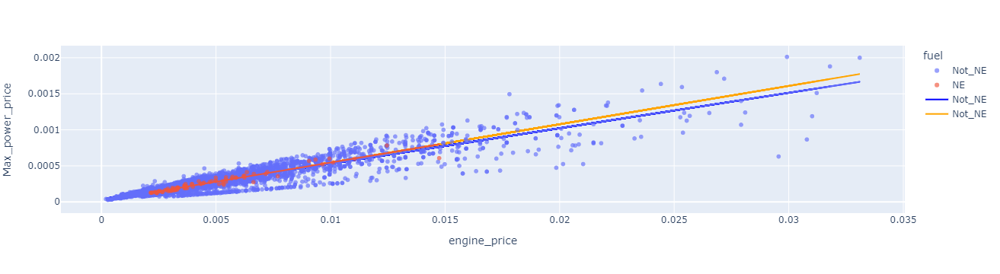

In [153]:
fig = px.scatter(
    data, x="engine_price", y="Max_power_price", color="fuel", opacity=0.65,
    trendline='ols'
)
fig.add_trace(
    go.Scatter(x=data['engine_price'],y=0.0491787*data['engine_price']+3.91218e-05, name='Not_NE', line_shape = 'linear',line_color= "Blue")
)
fig.add_trace(
    go.Scatter(x=data['engine_price'],y=0.053198*data['engine_price']+1.39894e-05, name='Not_NE', line_shape = 'linear',line_color= "orange")
)
fig.show()

In [154]:
data = data[data['engine_price'] < 0.015] 

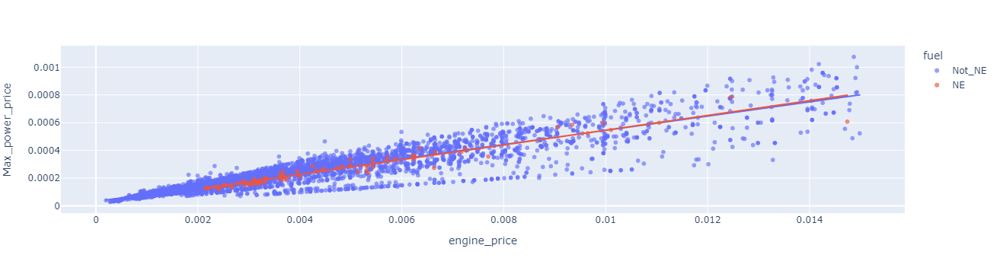

In [155]:
fig = px.scatter(
    data, x="engine_price", y="Max_power_price", color="fuel", opacity=0.65,
    trendline='ols'
)

fig.show()

data1 = data.drop(data[data['fuel'] == 'Not_NE'].sample(frac=.9).index)

fig = px.scatter(
    data1, x="engine_price", y="Max_power_price", color="fuel", opacity=0.65,
    trendline='ols'
)


fig.show()

# Gas emission

In [156]:
df3

,Unnamed: 0,Maker,Genmodel,Year,Price,Gas_emission,Fuel_type,Engine_size
0,0,Abarth,124 spider,2016,29365,148,Petrol,1368
1,1,Abarth,124 spider,2016,31365,153,Petrol,1368
2,2,Abarth,124 spider,2017,29365,148,Petrol,1368
3,3,Abarth,124 spider,2017,31365,153,Petrol,1368
4,4,Abarth,124 spider,2017,26665,148,Petrol,1368
...,...,...,...,...,...,...,...,...
335557,335557,Volvo,Xc40,2018,35250,163,Petrol,1969
335558,335558,Volvo,Xc40,2018,36750,166,Petrol,1969
335559,335559,Volvo,Xc40,2018,29200,144,Petrol,1477
335560,335560,Volvo,Xc40,2018,33350,161,Petrol,1969


In [157]:
df3['Fuel_type'] = df3['Fuel_type'].replace('Diesel','Not_NE')
df3['Fuel_type'] = df3['Fuel_type'].replace('Petrol','Not_NE')
df3['Fuel_type'] = df3['Fuel_type'].replace('Other','NE')
df3['Fuel_type'] = df3['Fuel_type'].replace('Electric Diesel REX','NE')

In [158]:
data = df3.drop(['Maker','Genmodel','Price','Engine_size','Unnamed: 0'],axis =1)
data

,Year,Gas_emission,Fuel_type
0,2016,148,Not_NE
1,2016,153,Not_NE
2,2017,148,Not_NE
3,2017,153,Not_NE
4,2017,148,Not_NE
...,...,...,...
335557,2018,163,Not_NE
335558,2018,166,Not_NE
335559,2018,144,Not_NE
335560,2018,161,Not_NE


In [159]:
test = data.loc[data['Fuel_type'] =='NE']
test

,Year,Gas_emission,Fuel_type
9424,2014,37,NE
9911,2015,37,NE
9912,2015,37,NE
9988,2015,38,NE
10521,2016,37,NE
...,...,...,...
335373,1999,264,NE
335380,1999,264,NE
335381,1999,264,NE
335446,2000,264,NE


## Value retention

In [160]:
df3

,Unnamed: 0,Maker,Genmodel,Year,Price,Gas_emission,Fuel_type,Engine_size
0,0,Abarth,124 spider,2016,29365,148,Not_NE,1368
1,1,Abarth,124 spider,2016,31365,153,Not_NE,1368
2,2,Abarth,124 spider,2017,29365,148,Not_NE,1368
3,3,Abarth,124 spider,2017,31365,153,Not_NE,1368
4,4,Abarth,124 spider,2017,26665,148,Not_NE,1368
...,...,...,...,...,...,...,...,...
335557,335557,Volvo,Xc40,2018,35250,163,Not_NE,1969
335558,335558,Volvo,Xc40,2018,36750,166,Not_NE,1969
335559,335559,Volvo,Xc40,2018,29200,144,Not_NE,1477
335560,335560,Volvo,Xc40,2018,33350,161,Not_NE,1969


In [161]:
df4 = df3[df3['Year'] < 2019] 

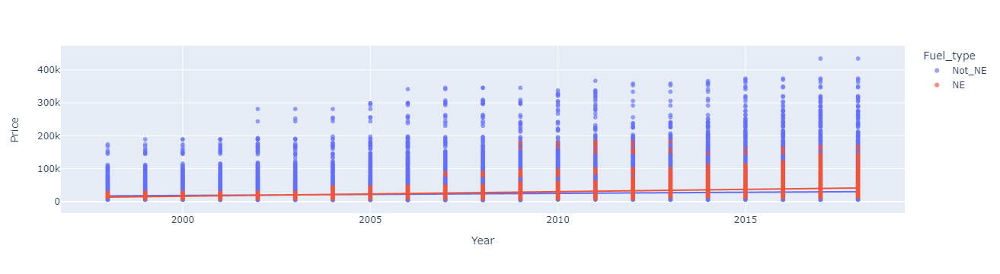

In [162]:
fig = px.scatter(
    df4, x="Year", y="Price", color="Fuel_type", opacity=0.65,
    trendline='ols'
)
layout = go.Layout(hovermode=False)
fig.show()

In [163]:
df5 = df3.loc[~((df3['Year'] != 2018) & (df3['Year'] != 2010)),:]

In [164]:
df5

,Unnamed: 0,Maker,Genmodel,Year,Price,Gas_emission,Fuel_type,Engine_size
5,5,Abarth,124 spider,2018,29365,148,Not_NE,1368
6,6,Abarth,124 spider,2018,31365,153,Not_NE,1368
7,7,Abarth,124 spider,2018,33365,148,Not_NE,1368
8,8,Abarth,124 spider,2018,35365,153,Not_NE,1368
9,9,Abarth,124 spider,2018,26665,148,Not_NE,1368
...,...,...,...,...,...,...,...,...
335557,335557,Volvo,Xc40,2018,35250,163,Not_NE,1969
335558,335558,Volvo,Xc40,2018,36750,166,Not_NE,1969
335559,335559,Volvo,Xc40,2018,29200,144,Not_NE,1477
335560,335560,Volvo,Xc40,2018,33350,161,Not_NE,1969


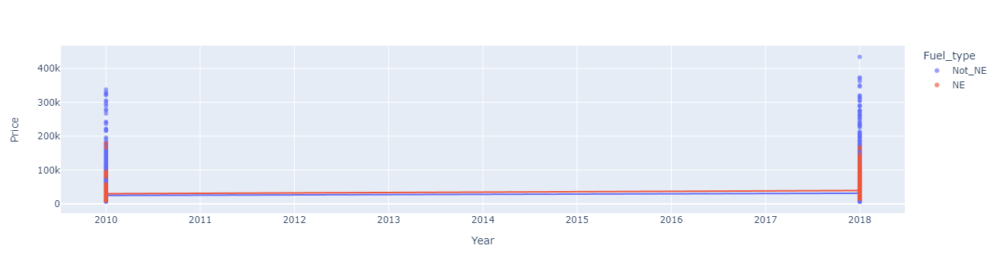

In [165]:
fig = px.scatter(
    df5, x="Year", y="Price", color="Fuel_type", opacity=0.65,
    trendline='ols'
)
layout = go.Layout(hovermode=False)
fig.show()

In [166]:
df5 = df5.drop(['Gas_emission','Engine_size'],axis=1)
df5.head()

,Unnamed: 0,Maker,Genmodel,Year,Price,Fuel_type
5,5,Abarth,124 spider,2018,29365,Not_NE
6,6,Abarth,124 spider,2018,31365,Not_NE
7,7,Abarth,124 spider,2018,33365,Not_NE
8,8,Abarth,124 spider,2018,35365,Not_NE
9,9,Abarth,124 spider,2018,26665,Not_NE


In [167]:
maker = df5['Maker'].unique()

In [168]:

new_maker=[]
avalible_maker=[]

for name in maker:
    data = df5.loc[df5['Maker']==name]
    if 'Not_NE' in data.values and 'NE' in data.values:
        new_maker.append(name)
        
for name in new_maker:
    data = df5.drop(df5[(df5['Maker'] != name)].index)
    data = data.drop(data[data['Fuel_type'] != 'NE'].index)
    if 2018 in data.values and 2010 in data.values:
        avalible_maker.append(name)
avalible_maker

['Citroen',
 'Ford',
 'Infiniti',
 'Lexus',
 'Mitsubishi',
 'Nissan',
 'Peugeot',
 'Porsche',
 'Toyota',
 'Volkswagen',
 'Volvo']

In [169]:
Value_retention = pd.DataFrame(columns=['Maker','NEV_Value_retention_rate','Not_NEV_Value_retention_rate'])
Value_retention['Maker'] = avalible_maker
Value_retention = Value_retention.set_index('Maker')
Value_retention

,NEV_Value_retention_rate,Not_NEV_Value_retention_rate
Maker,,
Citroen,NaN,NaN
Ford,NaN,NaN
Infiniti,NaN,NaN
Lexus,NaN,NaN
Mitsubishi,NaN,NaN
Nissan,NaN,NaN
Peugeot,NaN,NaN
Porsche,NaN,NaN
Toyota,NaN,NaN


In [170]:
data = df5.drop(df5[(df5['Maker'] != 'Volvo')].index)
data = data.drop(data[data['Fuel_type'] != 'Not_NE'].index)
data

,Unnamed: 0,Maker,Genmodel,Year,Price,Fuel_type
317771,317771,Volvo,C30,2010,17635,Not_NE
317772,317772,Volvo,C30,2010,17940,Not_NE
317773,317773,Volvo,C30,2010,18190,Not_NE
317774,317774,Volvo,C30,2010,19885,Not_NE
317775,317775,Volvo,C30,2010,20190,Not_NE
...,...,...,...,...,...,...
335557,335557,Volvo,Xc40,2018,35250,Not_NE
335558,335558,Volvo,Xc40,2018,36750,Not_NE
335559,335559,Volvo,Xc40,2018,29200,Not_NE
335560,335560,Volvo,Xc40,2018,33350,Not_NE


In [171]:
old = data.drop(data[data['Year'] != 2010].index)
new = data.drop(data[data['Year'] != 2018].index)
old

,Unnamed: 0,Maker,Genmodel,Year,Price,Fuel_type
317771,317771,Volvo,C30,2010,17635,Not_NE
317772,317772,Volvo,C30,2010,17940,Not_NE
317773,317773,Volvo,C30,2010,18190,Not_NE
317774,317774,Volvo,C30,2010,19885,Not_NE
317775,317775,Volvo,C30,2010,20190,Not_NE
...,...,...,...,...,...,...
335010,335010,Volvo,Xc90,2010,49535,Not_NE
335011,335011,Volvo,Xc90,2010,45480,Not_NE
335012,335012,Volvo,Xc90,2010,47480,Not_NE
335013,335013,Volvo,Xc90,2010,45535,Not_NE


In [172]:
old_price = old['Price'].mean()
new_price = new['Price'].mean()
rate = old_price/new_price
rate

0.8146698656304029

In [173]:
def get_rate(data , maker, fuel):
    data = data.drop(data[(data['Maker'] != name)].index)
    data = data.drop(data[data['Fuel_type'] != fuel].index)
    old = data.drop(data[data['Year'] != 2010].index)
    new = data.drop(data[data['Year'] != 2018].index)
    old_price = old['Price'].mean()
    new_price = new['Price'].mean()
    rate = old_price/new_price 
    return rate

for name in avalible_maker:
    Value_retention.at[name,'NEV_Value_retention_rate'] = get_rate(df5,name,'NE')
    Value_retention.at[name,'Not_NEV_Value_retention_rate'] = get_rate(df5,name,'Not_NE')

In [174]:
Value_retention=Value_retention.reset_index()
Value_retention

,Maker,NEV_Value_retention_rate,Not_NEV_Value_retention_rate
0,Citroen,1.619374,0.761269
1,Ford,0.656785,0.783848
2,Infiniti,1.034598,1.263009
3,Lexus,1.144789,0.628264
4,Mitsubishi,0.811333,0.821036
5,Nissan,1.011154,0.793045
6,Peugeot,0.763293,0.676423
7,Porsche,0.680754,0.809839
8,Toyota,0.938502,0.866261
9,Volkswagen,0.560462,0.867956


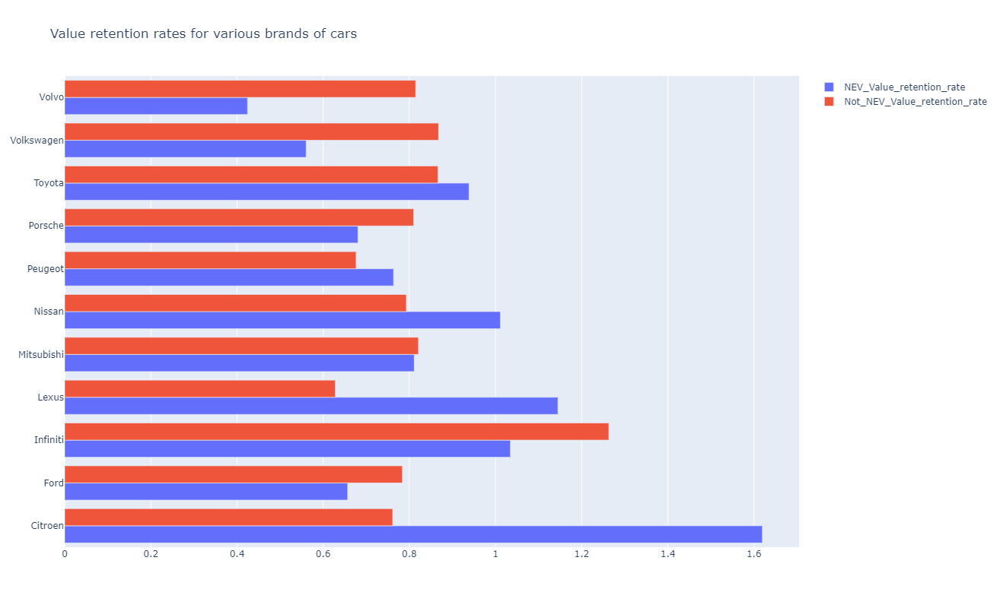

In [129]:
y_axis =Value_retention['Maker']

fig = go.Figure(data=[
    go.Bar(name='NEV_Value_retention_rate', x=Value_retention['NEV_Value_retention_rate'], y=y_axis,orientation='h'),
    go.Bar(name='Not_NEV_Value_retention_rate', x=Value_retention['Not_NEV_Value_retention_rate'], y=y_axis,orientation='h')
])

# Change the bar mode
fig.layout.update(width=1200,
    height=800,barmode='group',
                 title_text = 'Value retention rates for various brands of cars')
fig